# Unveiling the Power of GenAI: Extracting Insights from Chats
Notebook developed for a workshop at Women in Tech Summit 2024

## Import libraries

In [1]:
import configparser
import os
import pickle
import re
import warnings

import emoji
import nltk
# nltk.download('punkt')
import numpy as np
import pandas as pd
import plotly.express as px
from langdetect import detect

warnings.filterwarnings('ignore')

## Source data

We use Kaggle dataset called Customer Support on Twitter for this workshop, you'll find it here: https://www.kaggle.com/datasets/thoughtvector/customer-support-on-twitter.

To run the preprocessing part of our notebook, unzip the data and copy it to the data/raw_data folder.

In [ ]:
df_conv = pd.read_csv("data/raw_data/csc_twitter/twcs/twcs.csv")

## Data preprocessing

In [ ]:
def add_conv_id(df):
    '''
    Identify which tweets belong to the same conversation
    '''
    df['conversation_id'] = df['tweet_id']
    whole = df.shape[0]
    for i in range(len(df)):
        if i % 100000 == 0:
            print("{} out of {} were preprocessed".format(i, whole))
        prev_tweet = df.loc[i, 'in_response_to_tweet_id']
        if not np.isnan(prev_tweet):
            df_temp = df[df['tweet_id']==prev_tweet]
            if len(df_temp) > 0:
                new_conv_id = df_temp['conversation_id'].values[0]
                df.loc[i, 'conversation_id'] = new_conv_id


def filter_data(df_filtered):
    # Remove additinal whitespaces
    WHITESPACES_CLEANER = re.compile(r'(\uFEFF|\s)+')
    df_filtered['text'] = df_filtered['text'].str.replace(WHITESPACES_CLEANER, ' ', regex=True)
    
    # Align punctuation
    WHITESPACES_BEFORE_PUNCTUATION_CLEANER = re.compile(r'(\w)\s+([.,;:?!])')
    df_filtered['text'] = df_filtered['text'].str.replace(WHITESPACES_BEFORE_PUNCTUATION_CLEANER, r'\1\2', regex=True)
    
    # Filter out empty strings
    df_filtered = df_filtered[df_filtered['text']!=""]

    # Filter out emoticons
    df_filtered_emot = df_filtered['text'].apply(lambda s: emoji.replace_emoji(s, ''))
    df_filtered['text'] = df_filtered_emot

    # Filter out one char strings
    df_filtered = df_filtered.loc[df_filtered['utterance_size'] > 1, :]
    
    # Replace web links
    LINK_CLEANER = re.compile(r'\b(?:https?://)\S+', flags=re.IGNORECASE)
    df_filtered['text'] = df_filtered['text'].str.replace(LINK_CLEANER, '[link]', regex=True)
    
    return df_filtered


def detect_lang(x):
    '''
    Detect the language of the input text
    '''
    try:
        lang = detect(x)
    except:
        lang = 'unknown'
    return lang

In [ ]:
def preprocessing(df):
    # Transform create_at column to datetime
    print("Transforming create_at column to datetime")
    df['created_at'] = pd.to_datetime(df['created_at'], errors='coerce')

    # Order data by create date
    print("Ordering data by create date")
    df.sort_values(by='created_at', ignore_index=True, inplace=True)

    # Add conversation_id 
    print("Adding conversation_id")
    add_conv_id(df)

    # Add author_type
    print("Adding author_type")
    df['author_type'] = df['author_id'] .map(lambda x: "user" if x.isnumeric() else "support")

    # Delete links to previous tweets from text body
    print("Deleting links to previous tweets from text body")
    df_filtered = df.copy(deep=True)
    df_filtered['text'] = df_filtered['text'].apply(lambda s: re.sub("@\S+ |@\S+$", "", s))

    print("Adding columns related to text length")
    # Add number of characters in the utterance 
    df_filtered['utterance_size'] = df_filtered['text'].str.len()
    # Add number of tokens in the utterance 
    df_filtered['utterance_tokens_size'] = df_filtered['text'].apply(lambda x: len(str(x).split(' ')))

    print("Limiting data to AppleSupport")
    # Limit data to AppleSupport - one company, choosing based on number of records in the data
    conversation_id_apple = df_filtered.loc[df_filtered['author_id']=='AppleSupport', 'conversation_id'].unique()
    df_filtered = df_filtered[df_filtered['conversation_id'].isin(conversation_id_apple)]
    
    print("Filtering data")
    df_filtered = filter_data(df_filtered)

    print("Adding information about conversation language")
    # Add language info
    df_filtered['utterance_lang'] = df_filtered.loc[:, 'text'].apply(lambda x: detect_lang(x))
    conv_lang = df_filtered.groupby(['conversation_id']).apply(lambda x: x.sort_values('utterance_size', ascending=False).iloc[0]['utterance_lang'])
    df_conv_lang = conv_lang.to_frame().rename(columns={0: "conversation_lang"})
    df_filtered = df_filtered.merge(df_conv_lang, left_on='conversation_id', right_index=True)

    return df_filtered

In [ ]:
df_conv_filtered = preprocessing(df_conv)

In [ ]:
# Save preprocessed data to a file
# df_conv_filtered.to_csv("data/preprocessed_data/apple_support.csv")
# df_conv_filtered.to_parquet("data/preprocessed_data/apple_support.parq")

### Examples before and after preprocessing

In [2]:
df_conv = pd.read_csv("data/raw_data/csc_twitter/twcs/twcs.csv")
# Transform create_at column to datetime
df_conv['created_at'] = pd.to_datetime(df_conv['created_at'], errors='coerce')
# Order data by create date
df_conv.sort_values(by='created_at', ignore_index=True, inplace=True)

df_conv_filtered = pd.read_parquet("data/preprocessed_data/apple_support.parq")

In [3]:
# before preprocessing
for idx, item in df_conv.loc[df_conv['tweet_id'].isin([363663, 363661, 363662])].iterrows():
    print(f"{item['tweet_id']} | {item['author_id']} | {item['text']}")

363663 | 202183 | @AppleSupport Howdy. Today I started getting a "No Sim Card Installed" message on my iPhone 6. I'm running 9.2.1
???
363661 | AppleSupport | @202183 We would love to help fix this. Follow these steps and DM us if you need further assistance: https://t.co/UTP2qBzCA0
363662 | 202183 | @AppleSupport Howdy. I will be upgrading my 7 to the X very early in the morning on the 27th. Will there be an Apple battery case for the X eventually?


In [4]:
# after preprocessing
selected_conv_id = 363663
for idx, item in df_conv_filtered.loc[df_conv_filtered['conversation_id'] == selected_conv_id, :].iterrows():
    print(f"{item['tweet_id']} | {item['author_id']} | {item['text']}")

363663 | 202183 | Howdy. Today I started getting a "No Sim Card Installed" message on my iPhone 6. I'm running 9.2.1???
363661 | AppleSupport | We would love to help fix this. Follow these steps and DM us if you need further assistance: [link]
363662 | 202183 | Howdy. I will be upgrading my 7 to the X very early in the morning on the 27th. Will there be an Apple battery case for the X eventually?


In [5]:
# before preprocessing
for idx, item in df_conv.loc[df_conv['tweet_id'].isin([1700946, 1700945, 1700944, 1700943, 1700941, 1700942])].iterrows():
    print(f"{item['tweet_id']} | {item['author_id']} | {item['text']}")

1700946 | 515770 | @145741 listed phone #’s don’t work, your live chat goes unanswered, &amp; you don’t respond to DMs. do you not understand customer service?
1700945 | 515771 | @515770 wow! you're going to Iceland? 😲
1700944 | 515770 | @515771 I️ was supposed to, but sadly, I️ have to cancel the trip... if i️ ever get through to them 🙄🙄🙄
1700943 | 515770 | @515771 @AppleSupport WHAT IS WRONG WITH EVERYONE’S PHONE. FIX I️t.
1700941 | AppleSupport | @515770 Here’s what you can do to work around the issue until it’s fixed in a future software update: https://t.co/xXaXeeSRt9
1700942 | 515770 | @AppleSupport how is THIS the bug that slipped by? 😂 @68292


In [6]:
# after preprocessing
selected_conv_id = 1700946
for idx, item in df_conv_filtered.loc[df_conv_filtered['conversation_id'] == selected_conv_id, :].iterrows():
    print(f"{item['tweet_id']} | {item['author_id']} | {item['text']}")

1700946 | 515770 | listed phone #’s don’t work, your live chat goes unanswered, &amp; you don’t respond to DMs. do you not understand customer service?
1700945 | 515771 | wow! you're going to Iceland? 
1700944 | 515770 | I was supposed to, but sadly, I have to cancel the trip... if i ever get through to them 
1700943 | 515770 | WHAT IS WRONG WITH EVERYONE’S PHONE. FIX It.
1700941 | AppleSupport | Here’s what you can do to work around the issue until it’s fixed in a future software update: [link]
1700942 | 515770 | how is THIS the bug that slipped by?  


## Exploratory Data Analysis on preprocessed data

In [ ]:
# # Read data from file
# df_conv_filtered = pd.read_parquet("data/preprocessed_data/apple_support.parq")
# # Transform create_at column to datetime
# df_conv_filtered['created_at'] = pd.to_datetime(df_conv_filtered['created_at'], errors='coerce')

In [7]:
df_conv_filtered.head()

,tweet_id,author_id,inbound,created_at,text,response_tweet_id,in_response_to_tweet_id,conversation_id,author_type,utterance_size,utterance_tokens_size,utterance_lang,conversation_lang
101,2473568,707262,True,2013-05-04 22:04:43+00:00,Sorry for party rockin,2473567,NaN,2473568,user,22,4,en,en
697,1753300,528133,True,2015-11-08 03:11:30+00:00,"Once a flirt, always a flirt.",1753299,NaN,1753300,user,29,6,en,en
929,2833060,AppleSupport,False,2016-03-03 13:00:08+00:00,Welcome to... [link],"2833061,2833059",NaN,2833060,support,37,3,en,en
930,363663,202183,True,2016-03-04 01:19:41+00:00,"Howdy. Today I started getting a ""No Sim Card ...",363661,NaN,363663,user,102,18,en,en
931,363661,AppleSupport,False,2016-03-04 20:44:00+00:00,We would love to help fix this. Follow these s...,363662,363663.0,363663,support,116,19,en,en


In [8]:
df_conv_filtered['conversation_id'].nunique()

80717

### Number of conversations over time

In [9]:
df_conv_created = df_conv_filtered[['conversation_id', 'created_at']]
df_conv_created['created_month']= df_conv_filtered['created_at'].dt.strftime('%Y-%m')
df_conv_vs_time = df_conv_created.groupby('created_month', as_index=False)
df_conv_vs_time = df_conv_vs_time.agg(conversation_count=pd.NamedAgg(column="conversation_id", aggfunc="nunique"))

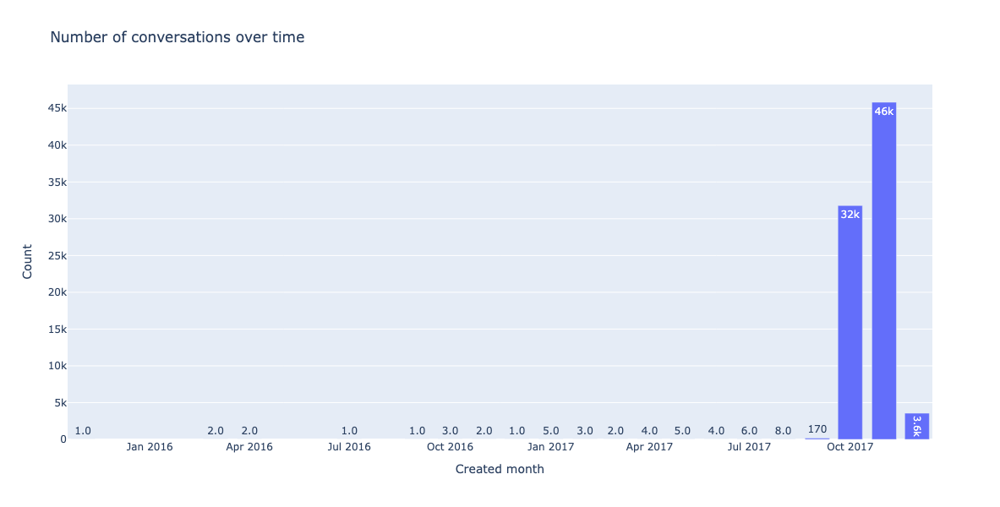

In [10]:
fig = px.bar(df_conv_vs_time[(df_conv_vs_time['created_month']>='2014-01') & (df_conv_vs_time['created_month']<='2024-04')], x='created_month', y='conversation_count',
             title="Number of conversations over time",
            height=600,
            text_auto='.2s'
            )
fig.update_layout(xaxis_title='Created month',
                  yaxis_title='Count')

fig.show()

### Number of tweets per conversation

In [11]:
df_conv_length = df_conv_filtered.groupby('conversation_id')
df_conv_length = df_conv_length.agg(
    conversation_length=pd.NamedAgg(column="tweet_id", aggfunc="count"),
    conversation_size=pd.NamedAgg(column="utterance_size", aggfunc="sum")
)
conversation_count_vs_length = (df_conv_length[['conversation_length']].value_counts().to_frame().reset_index()).rename(columns={0: 'count'}).sort_values('count')

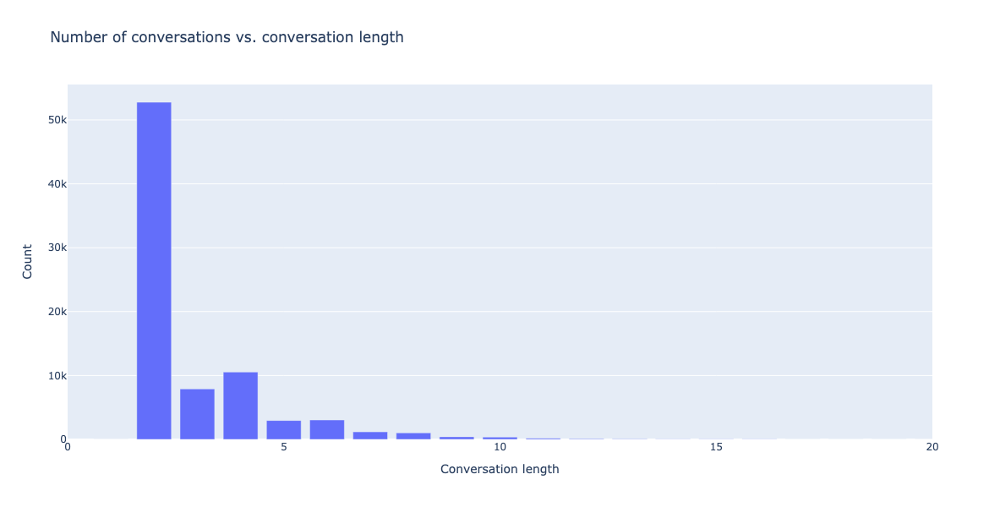

In [12]:
fig = px.bar(
    conversation_count_vs_length, 
    x='conversation_length', 
    y='count',
    title="Number of conversations vs. conversation length",
    height=600
)
fig.update_xaxes(range=[0, 20])
fig.update_layout(
    xaxis_title='Conversation length',
    yaxis_title='Count'
)
fig.show()

## Preparing training data

In [13]:
# Select time frames and English language
begin_date = '2017-09-01'
end_date = '2017-12-31'
selection_mask = (df_conv_filtered['created_at'] >= begin_date) & \
                 (df_conv_filtered['created_at'] < end_date) & \
                 (df_conv_filtered['conversation_lang'] == 'en')
df_conv_selected = df_conv_filtered[selection_mask]

# Add who's talking: user or support to tweet text
df_conv_selected['text'] = df_conv_selected['author_type'] + ': ' + df_conv_selected['text']

# Join messages into one conversation
df_conversations = df_conv_selected.groupby(['conversation_id'], as_index=False).agg(
    conversation_length=pd.NamedAgg(column="tweet_id", aggfunc="count"),
    conversation_body=pd.NamedAgg(column="text", aggfunc=lambda x: '\n'.join(x.astype(str))), 
    conversation_date=pd.NamedAgg(column="created_at", aggfunc="first")
)

# Count number of tokens (words) in each conversation
df_conv_tokens = df_conv_selected[['conversation_id', 'utterance_tokens_size']]
df_conv_tokens = df_conv_tokens.groupby(['conversation_id'])['utterance_tokens_size'].sum()
df_conv_tokens = df_conv_tokens.to_frame().reset_index().rename(columns={'utterance_tokens_size': 'conv_tokens_count'})

# Add info about number of tokens
df_conversations = df_conversations.merge(df_conv_tokens, how='left', on='conversation_id')

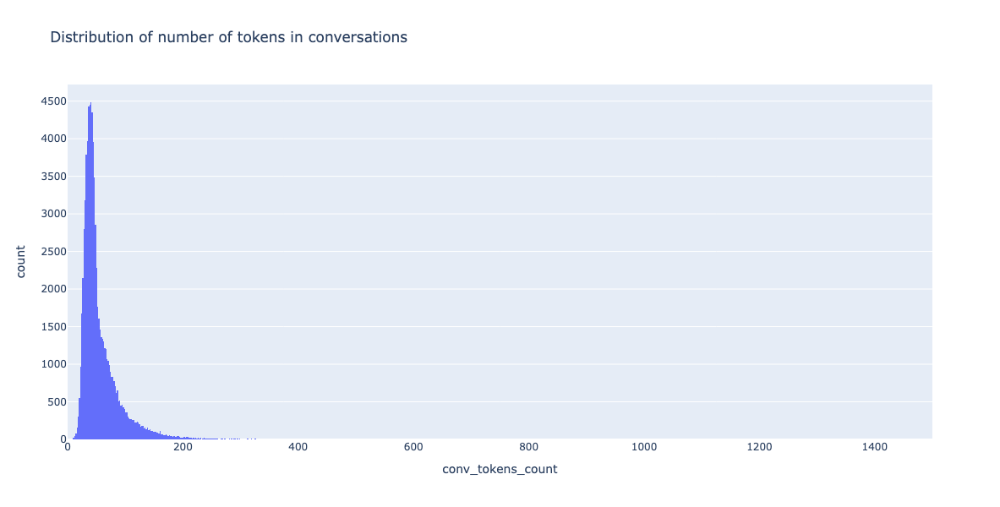

In [14]:
fig = px.histogram(
    df_conversations, 
    x='conv_tokens_count', 
    title="Distribution of number of tokens in conversations",
    height=600
)
fig.update_xaxes(range=[0, 1500])
fig.show()

In [15]:
# Cut too long conversations - max_tokens is set based on distribution of number of tokens in conversation
print(df_conversations[['conv_tokens_count']].quantile(0.99))
max_tokens = 198
df_conversations['conversation_body'] = df_conversations['conversation_body'].apply(lambda x: ' '.join(str(x).split(' ')[:max_tokens]))

conv_tokens_count    198.0
Name: 0.99, dtype: float64


### Remove duplicated conversations

In [16]:
# All duplicated conversations ('keep=False' marks all duplicates as True)
df_duplicated_convs = df_conversations.loc[df_conversations['conversation_body'].duplicated(keep=False), :]

# Count duplicates and represent duplicates by the first occurrence
df_duplicated_conv_count = df_duplicated_convs.groupby('conversation_body', as_index=False).agg(
    conversations_count=pd.NamedAgg(column="conversation_id", aggfunc="count"),
    conversation_id=pd.NamedAgg(column="conversation_id", aggfunc="first")
)[['conversation_id', 'conversation_body', 'conversations_count']].sort_values('conversations_count', ascending=False)

# Define unique conversations
df_conv_unique = df_conversations[~df_conversations['conversation_body'].duplicated()].reset_index(drop=True)
df_conv_unique['conversation_month']= df_conv_unique['conversation_date'].dt.strftime('%Y-%m')
df_conv_unique = df_conv_unique.merge(df_duplicated_conv_count, how='left', on=['conversation_id', 'conversation_body'])
df_conv_unique = df_conv_unique.fillna({'conversations_count': 1}).astype({'conversations_count': int})

# Save the final data
# df_conv_unique.to_parquet("data/preprocessed_data/apple_support_training_data.parq")

In [17]:
# Read final data
# df_conv_unique = pd.read_parquet("data/preprocessed_data/apple_support_training_data.parq")

# Get conversations text as list
conversations_data = df_conv_unique['conversation_body'].tolist()

# Get timestamps as list
timestamps = df_conv_unique['conversation_date'].dt.strftime('%Y-%m').to_list()

In [18]:
# Examples of final conversations which will be used for training
for i in range(5):
    print('_' * 50)
    print(conversations_data[i])

__________________________________________________
user: why are my I’s changing not showing up correctly on any of my social media platforms? [link]
user:  [link]
support: We're here for you. Which version of the iOS are you running? Check from Settings &gt; General &gt; About.
user: The newest update. I made sure to download it yesterday.
support: Lets take a closer look into this issue. Select the following link to join us in a DM and we'll go from there. [link]
__________________________________________________
user: What is up with this “ I “
user: Why are my I’s question marks?
user: I need answers because it’s annoying 
support: We'd like to look into this with you. Which model do you have and is iOS 11.1 installed? Any steps tried so far?
user: I have an iPhone 7 Plus and yes I do
support: That's great it has iOS 11.1 as we can rule out being outdated. Any steps tried since this started? Do you recall when it started?
user: Last night
user: This is what it looks like [link]
sup

## Topic modelling using BERTopic

For more info on BERTopic, check out their website: https://maartengr.github.io/BERTopic/algorithm/algorithm.html.

In [19]:
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance, OpenAI, PartOfSpeech, TextGeneration
from bertopic.vectorizers import ClassTfidfTransformer
from hdbscan import HDBSCAN
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
from umap import UMAP

### Training

##### Detailed BERTopic pipeline
- Step 1 - Embedding documents using a Hugging Face Transformers model
- Step 2 - Reducing dimensionality of embeddings using UMAP: https://pair-code.github.io/understanding-umap/
- Step 3 - Clustering reduced embeddings into topics using HDBSCAN
- Step 4 - Tokenization of topics using CountVectorizer
- Step 5 - Weight tokens, create topic representation using C-TF-IDF
- Step 6 - (Optional) Fine-tune topic representations using KeyBERT

##### Calculate embeddings
Model used to calculate embeddings: https://huggingface.co/sentence-transformers/all-MiniLM-L6-v2.

In [20]:
# Extract embeddings
embedding_model = SentenceTransformer("all-MiniLM-L6-v2")
conversations_embeddings = embedding_model.encode(conversations_data, show_progress_bar=True)

Batches: 100%|██████████████████████████████| 2494/2494 [01:34<00:00, 26.52it/s]


In [ ]:
# embedding_model_gte_base = SentenceTransformer('thenlper/gte-base')
# conversations_embeddings_gte_base = embedding_model_gte_base.encode(conversations_data, show_progress_bar=True)

In [ ]:
# Save embeddings to a file
# np.save("conversations_embeddings", conversations_embeddings)

In [ ]:
# Load embeddings from a file
# conversations_embeddings = np.load("conversations_embeddings.npy")

##### Stopwords

Stopwords list downloaded from https://github.com/stopwords-iso/stopwords-en/blob/master/stopwords-en.txt

In [21]:
stopwords_list = pd.read_csv('stopwords-en.txt', header=None).astype(str)[0].tolist()
# sorted(stopwords_list)

In [22]:
# Disable warning:
# The current process just got forked. Disabling parallelism to avoid deadlocks... To disable this warning, please explicitly set 
# TOKENIZERS_PARALLELISM=(true | false)
os.environ["TOKENIZERS_PARALLELISM"] = "false"

Info about hyperparameter tuning: https://maartengr.github.io/BERTopic/getting_started/parameter%20tuning/parametertuning.html

In [23]:
# Reduce dimensionality
umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
# Cluster reduced embeddings
hdbscan_model = HDBSCAN(min_cluster_size=700, min_samples=50, metric='euclidean', cluster_selection_method='eom', prediction_data=True)
# Tokenize topics
vectorizer_model = CountVectorizer(stop_words=stopwords_list, min_df=10, ngram_range=(1, 2))
# Extract topic words
ctfidf_model = ClassTfidfTransformer(reduce_frequent_words=True)
# Fine-tune topic representations
## KeyBERT
keybert_model = KeyBERTInspired()

## MMR - Diversify topic representations
# mmr_model = MaximalMarginalRelevance(diversity=0.3)

## GPT-3.5 - generate human-readable lables
# client = openai.OpenAI(api_key="")
# prompt = """
# I have a topic that contains the following documents: 
# [DOCUMENTS]
# The topic is described by the following keywords: [KEYWORDS]

# Based on the information above, extract a short but highly descriptive topic label. Make sure it is in the following format:
# topic: <topic label>
# """
# openai_model = OpenAI(client, model="gpt-3.5-turbo", exponential_backoff=True, chat=True, prompt=prompt)

## All representation models
representation_model = {
    "KeyBERT": keybert_model,
    # "MMR": mmr_model,
    # "OpenAI": openai_model
}

## BERTopic model
conv_topic_model = BERTopic(
  # Pipeline models
  embedding_model=embedding_model,           # Step 1 - Extract embeddings
  umap_model=umap_model,                     # Step 2 - Reduce dimensionality
  hdbscan_model=hdbscan_model,               # Step 3 - Cluster reduced embeddings
  vectorizer_model=vectorizer_model,         # Step 4 - Tokenize topics
  ctfidf_model=ctfidf_model,                 # Step 5 - Extract topic words
  representation_model=representation_model, # Step 6 - (Optional) Fine-tune topic representations
    
  # Hyperparameters
  top_n_words=10, # 10 is default
  # nr_topics="auto",
  calculate_probabilities=True,
  verbose=True
)

In [24]:
conv_topics, conv_probs = conv_topic_model.fit_transform(conversations_data, conversations_embeddings)

2024-06-11 14:56:34,466 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
2024-06-11 14:57:31,525 - BERTopic - Dimensionality - Completed ✓
2024-06-11 14:57:31,527 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-06-11 14:57:45,885 - BERTopic - Cluster - Completed ✓
2024-06-11 14:57:45,894 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-06-11 14:57:52,306 - BERTopic - Representation - Completed ✓


In [ ]:
# conv_topic_model.save("conv_topic_model.pickle")

### BERTopic results

In [25]:
conv_topic_info = conv_topic_model.get_topic_info()
with pd.option_context('display.max_colwidth', None):
  display(conv_topic_info.set_index('Topic')[['Count', 'Name', 'Representation', 'KeyBERT']])

,Count,Name,Representation,KeyBERT
Topic,,,,
-1,15017,-1_siri_glitch_eye_alarm,"[siri, glitch, eye, alarm, app, podcast, support issue, fixed, future, fixed future]","[user iphone, ios 11, version ios, iphone, ios version, ios, user glitch, issue fixed, bug, glitch support]"
0,8835,0_battery_battery life_life_charge,"[battery, battery life, life, charge, charger, user battery, charging, iphone battery, draining, drain]","[battery draining, iphone battery, battery drain, battery drains, ios 11, draining battery, drains battery, updated ios, battery life, battery dies]"
1,6582,1_freezing_slow_freezes_apps,"[freezing, slow, freezes, apps, crashing, phone freezing, freeze, 6s, phone, support iphone]","[ios 11, updated ios, ios update, apps freezing, apps crashing, ios11, update iphone, phone crashing, iphone ios, phone freezing]"
2,5183,2_music_apple music_itunes_songs,"[music, apple music, itunes, songs, music app, album, itunes store, song, apple, apple pay]","[support itunes, itunes support, user itunes, itunes, apple music, music support, music app, music apple, music user, user music]"
3,3525,3_support iphone_cracked_iphone_details,"[support iphone, cracked, iphone, details, ios version, iphone link, phone, experiencing, phone support, options]","[iphone issues, issues iphone, experiencing iphone, iphone update, iphone support, support iphone, happening iphone, ios update, user iphone, iphone ios]"
4,2877,4_ios 11_11_ios11_update ios,"[ios 11, 11, ios11, update ios, user ios, downgrade, device update, ios, released assist, 11 info]","[ios 11, issues ios, ios11, updated ios, ios11 link, user ios11, ios11 support, ios10, update ios, iphone ios]"
5,2814,5_notifications_messages_contacts_imessage,"[notifications, messages, contacts, imessage, lock, lock screen, imessages, notification, whatsapp, texts]","[imessage support, messages support, support messages, messages app, messages send, imessages, messages user, messages, ios 11, messaging]"
6,2709,6_user link_support received_received_link support,"[user link, support received, received, link support, reaching workaround, workaround, workaround link, customer service, received continue, customer]","[support link, workaround link, link user, support send, issue link, user support, user link, link support, assist link, reaching workaround]"
7,2466,7_macbook_mac_sierra_macbook pro,"[macbook, mac, sierra, macbook pro, macos, pro, user macbook, laptop, imac, safe mode]","[macos sierra, macos running, macbookpro, macbook pro, user macbook, mac running, user sierra, sierra support, macbook, support mac]"


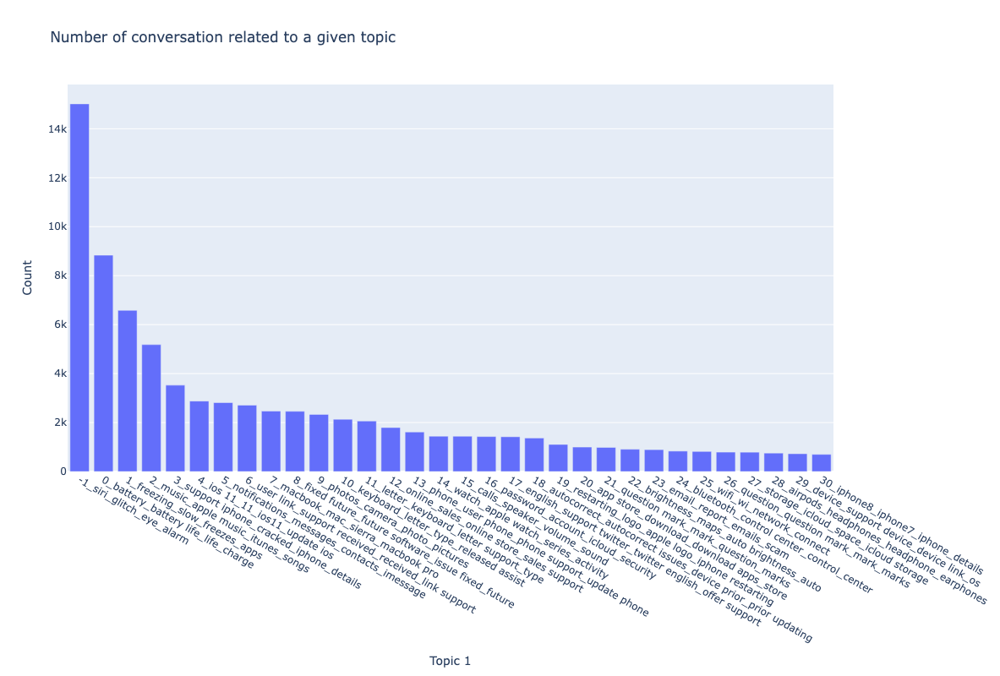

In [26]:
fig = px.bar(conv_topic_info, x='Name', y='Count',
             title="Number of conversation related to a given topic",
            height=800,
            # text_auto=True
            )
# fig.update_xaxes(range=[0, 100])
fig.update_layout(xaxis_title='Topic 1',
                  yaxis_title='Count')
fig.show()

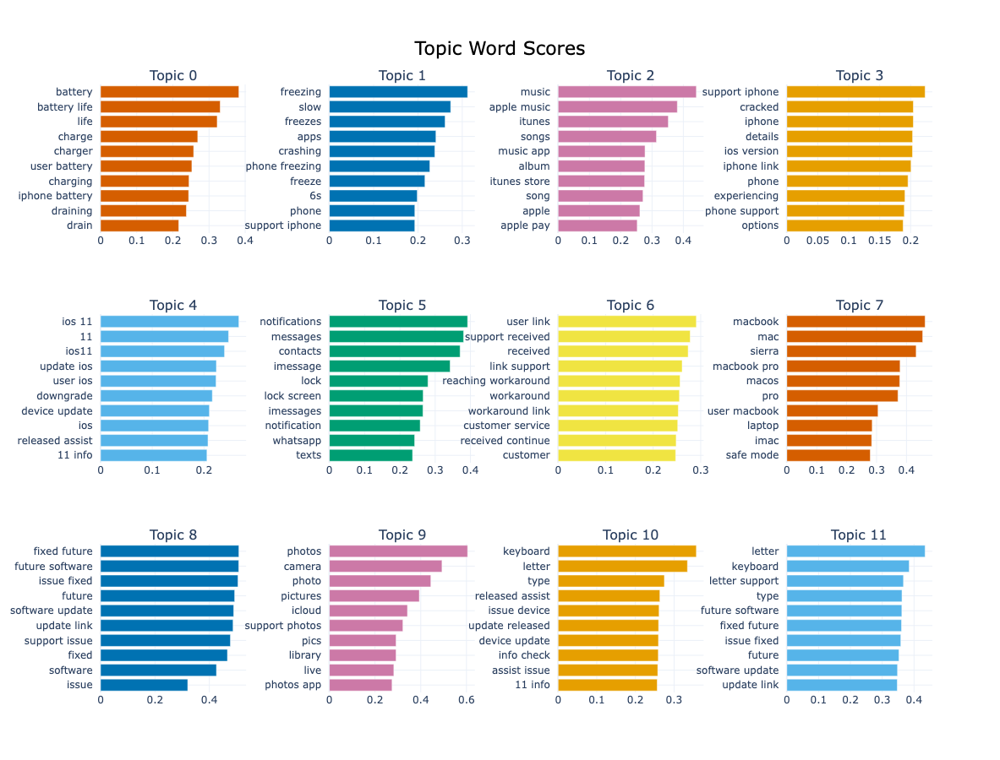

In [27]:
conv_topic_model.visualize_barchart(top_n_topics = 12, n_words = 10, height=300)

### Topic results over time

In [28]:
conv_topics_over_time = conv_topic_model.topics_over_time(conversations_data, timestamps)

4it [00:01,  2.06it/s]


In [29]:
def topics_over_time(conversations_data_topics, conv_topic_info):
    months = np.sort(conversations_data_topics['conversation_month'].unique())
    topics = conv_topic_info['Topic'].values
    
    topics_over_time = [pd.DataFrame(index=topics)]
    for month in months:
        col = conversations_data_topics.loc[conversations_data_topics['conversation_month']==month, 'Topic'].value_counts().to_frame()
        col = col.rename(columns={'count': month})
        topics_over_time.append(col)
        
    topics_over_time_df = pd.concat(topics_over_time, axis='columns').fillna(0).astype(int).transpose().reset_index().rename(columns={'index': 'Month'})
    topics_over_time_melt_df = topics_over_time_df.melt(id_vars='Month', var_name="Topic", value_name='Frequency')
    topics_over_time_melt_df = topics_over_time_melt_df.merge(conv_topic_info[['Topic', 'Name', 'Representation']], how='left', on='Topic')
    
    return topics_over_time_melt_df

In [30]:
conversations_data_topics = conv_topic_model.get_document_info(conversations_data).merge(df_conv_unique, how='left', left_index=True, right_index=True)
# Saving conversations_data_topics
conversations_data_topics.to_parquet("data/preprocessed_data/conversations_data_topics.parq")
plot_topics_over_time = topics_over_time(conversations_data_topics, conv_topic_info)

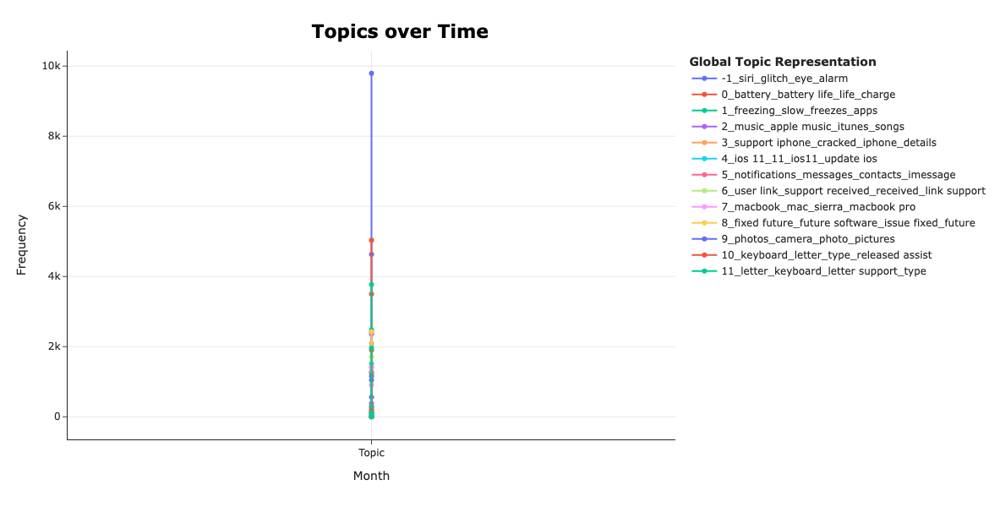

In [31]:
top_n = 12

fig = px.line(plot_topics_over_time[plot_topics_over_time['Topic']<top_n], 
              x='Month', y='Frequency', color='Name',
              markers=True,
              height=600)
fig.update_xaxes(showgrid=True)
fig.update_yaxes(showgrid=True)
fig.update_layout(legend_traceorder="normal") 
fig.update_layout(
    title={
        'text': f"<b>Topics over Time</b>",
        'y': .95,
        'x': 0.40,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(
            size=22,
            color="Black")
    },
    template="simple_white",
    width=1250,
    height=600,
    hoverlabel=dict(
        # bgcolor="white",
        font_size=16,
        font_family="Rockwell"
    ),
    legend=dict(
        title="<b>Global Topic Representation</b>",
    )
)
fig.show()

### Representative conversations

In [32]:
topic_nb_1 = 0

print(conv_topic_info.loc[topic_nb_1 + 1, 'Representation'])
print(conv_topic_info.loc[topic_nb_1 + 1, 'Count'])
print("#"*50)

for item in conv_topic_info.loc[topic_nb_1 + 1, 'Representative_Docs']:
    print(item)
    print("#"*50)

['battery', 'battery life', 'life', 'charge', 'charger', 'user battery', 'charging', 'iphone battery', 'draining', 'drain']
8835
##################################################
user: my phone just died while it was charging
user: can verify
user: im deadass looking at the pixle rn like what the heckle why did my phone die while it was charging????
support: We're here to help. Which iPhone do you have and what iOS is on it? Has it turned back on okay since that happened?
user: ios 11 iphone 6, works “normal” now but phone dies after 30 minutes sometimes less and sometimes with 80%+ battery life
support: Thanks! Can you confirm the specific iOS version from Settings &gt; General &gt; About &gt; Version, please?
user: 11.0.1
support: If your iPhone is backed up, we'd advise updating to the most recent version, 11.0.3 and testing to see if the issue continues.
##################################################
user: IPhone 6S battery discharges too soon after update of iOS 11 latest ver

### Topic probability distribution

In [33]:
selected_id = 76849
print(conversations_data_topics.loc[selected_id, "conversation_body"])

user: one hour online and in at 46% battery... 11.1.1/.2 didn't help. Where can i get updates on what you're doing to fix this?
support: We'd like to find out more about what's going on so we can help. Please send us a DM so we can get more info about this. [link]


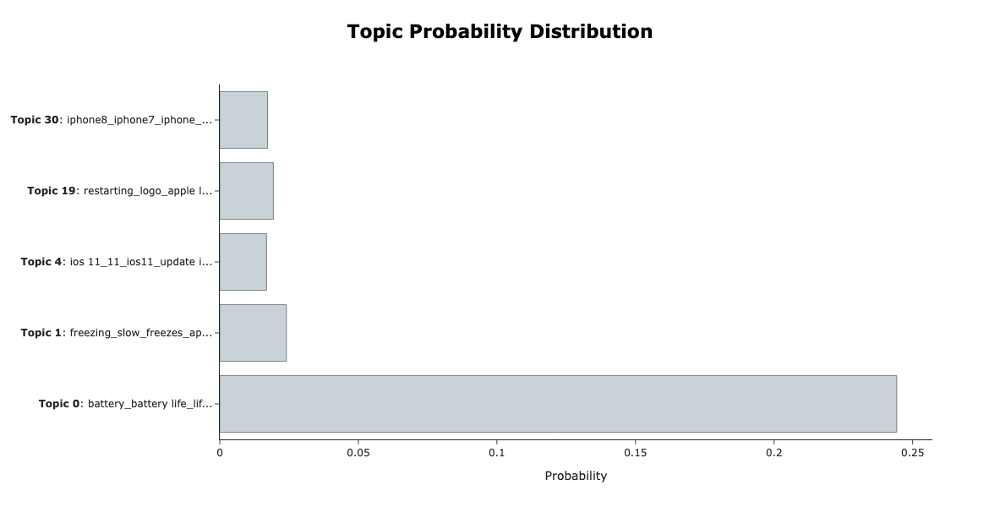

In [34]:
# Visualize the topic-document distribution for a single document
conv_topic_model.visualize_distribution(conv_topic_model.probabilities_[selected_id], custom_labels=True)

### How similar are documents in different topics?

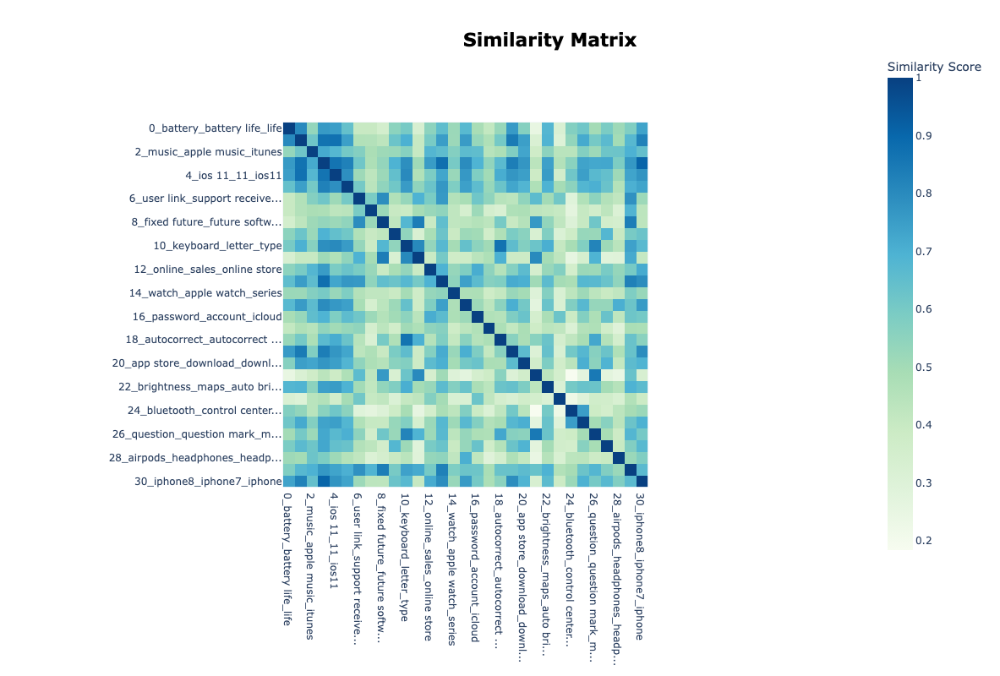

In [35]:
conv_topic_model.visualize_heatmap()

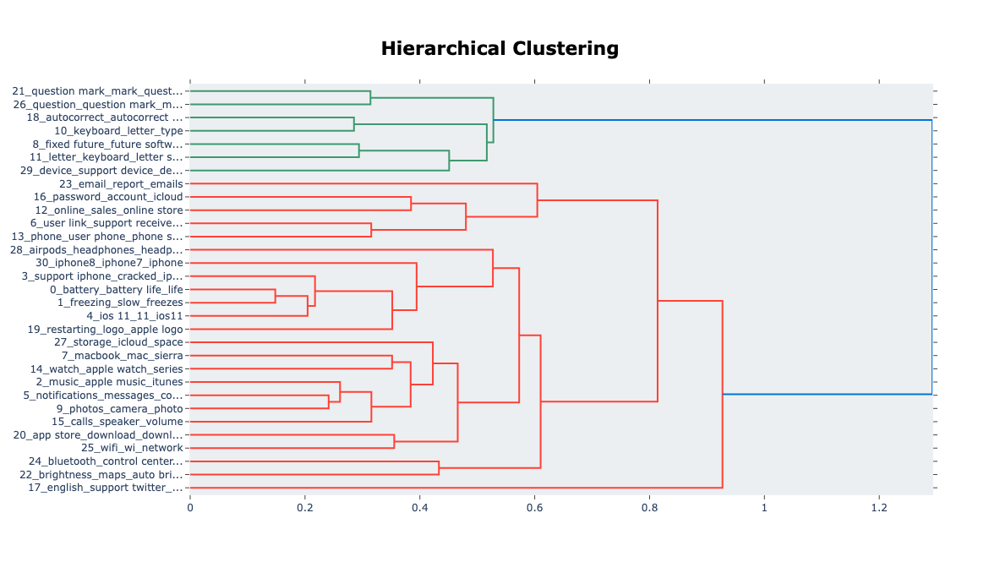

In [36]:
conv_topic_model.visualize_hierarchy()

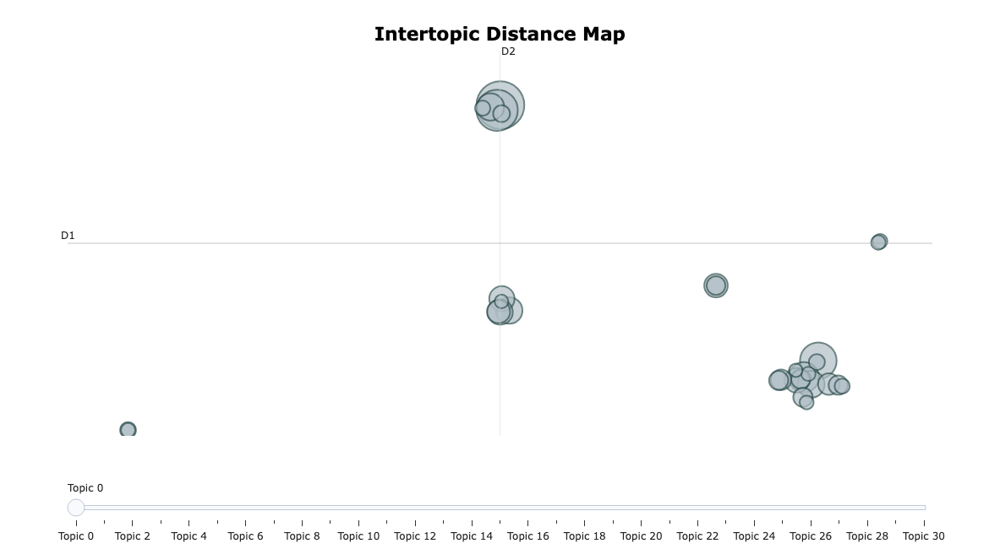

In [37]:
conv_topic_model.visualize_topics()

In [38]:
# We reduce our embeddings to 2D as it will allows us to quickly iterate later on
conversations_reduced_embeddings = UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine', 
                                        random_state=42).fit_transform(conversations_embeddings)

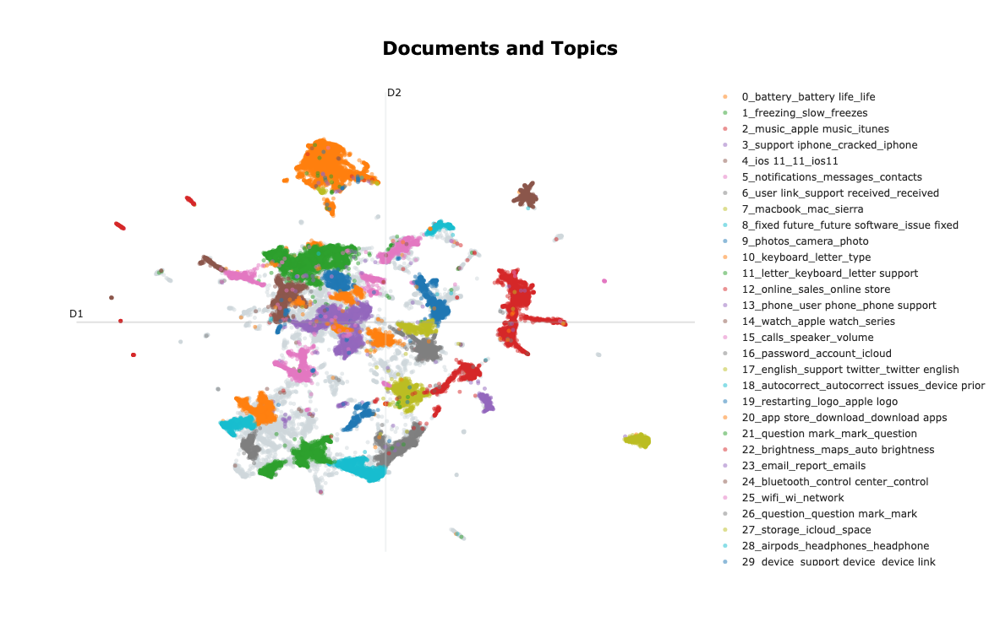

In [39]:
conv_topic_model.visualize_documents(conversations_data, reduced_embeddings=conversations_reduced_embeddings, 
                                       hide_document_hover=True, hide_annotations=True)

### Outlier reduction
Documentation on outlier reduction: https://maartengr.github.io/BERTopic/getting_started/outlier_reduction/outlier_reduction.html

In [40]:
print(f"Percentage of outliers: {conv_topic_info.loc[0, 'Count'] / conv_topic_info['Count'].sum() * 100:.4}%")
print("Number of outliers: ", (np.array(conv_topics) == -1).sum())

Percentage of outliers: 18.82%
Number of outliers:  15017


The default method for reducing outliers is by calculating the c-TF-IDF representations of outlier documents and assigning them to the best matching c-TF-IDF representations of non-outlier topics.

In [41]:
# You can use the `threshold` parameter to select the minimum distance or similarity when matching outlier documents with non-outlier topics. 
# This allows the user to change the amount of outlier documents are assigned to non-outlier topics.

# Reduce outliers using the `c-tf-idf` strategy
new_conv_topics = conv_topic_model.reduce_outliers(conversations_data, conv_topics, strategy="c-tf-idf", threshold=0.05)

In [42]:
print("Number of outliers after reduction with c-tf-idf: ", (np.array(new_conv_topics) == -1).sum())

Number of outliers after reduction with c-tf-idf:  70


When outlier documents are generated, they are not used when modeling the topic representations. These documents are completely ignored when finding good descriptions of topics. Hence, after having reduced the number of outliers in your topic model, you might want to update the topic representations with the documents that now belong to actual topics.


In [43]:
conv_topic_model.update_topics(conversations_data, topics=new_conv_topics)

2024-06-11 14:58:41,340 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


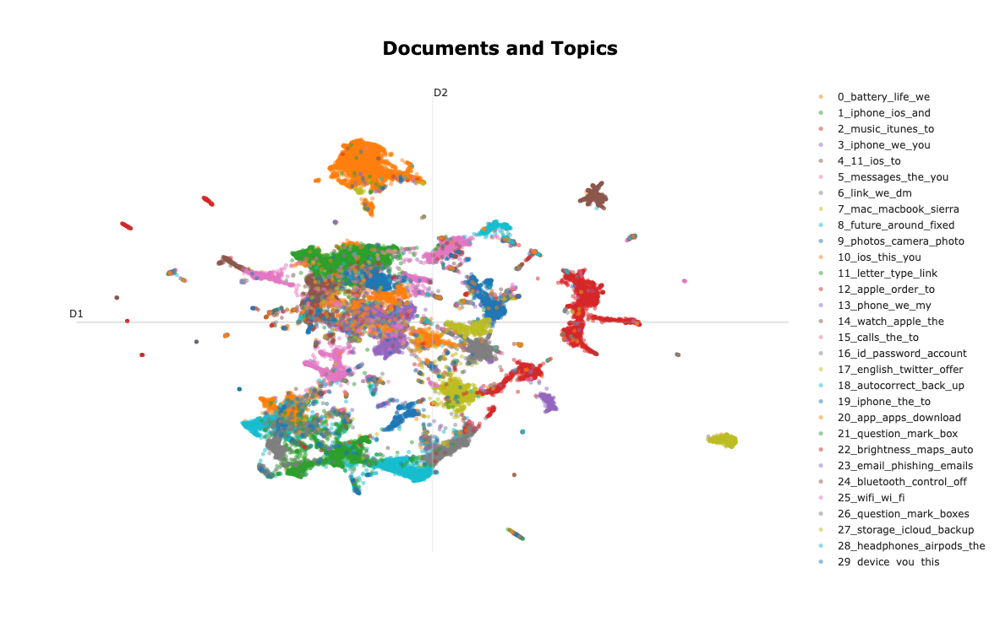

In [44]:
conv_topic_model.visualize_documents(conversations_data, reduced_embeddings=conversations_reduced_embeddings, 
                                       hide_document_hover=True, hide_annotations=True)

### Other possible improvements 
#### Outlier reduction - continuation
Use the topic distributions, as calculated with `.approximate_distribution` to find the most frequent topic in each outlier document. You can use the `distributions_params` variable to tweak the parameters of `.approximate_distribution`.

In [ ]:
# Reduce outliers using the `distributions` strategy
# new_conv_topics_d = conv_topic_model.reduce_outliers(conversations_data, conv_topics, strategy="distributions", threshold=0.08)
# print("Number of outliers after reduction with `distributions` strategy: ", (np.array(new_conv_topics_d) == -1).sum())

Probabilities strategy uses the soft-clustering as performed by HDBSCAN to find the best matching topic for each outlier document. To use this, make sure to calculate the `probabilities` beforehand by instantiating BERTopic with `calculate_probabilities=True`.

In [ ]:
# Reduce outliers using the `probabilities` strategy
# new_conv_topics_p = conv_topic_model.reduce_outliers(
#     conversations_data, 
#     conv_topics, 
#     probabilities=conv_probs, 
#     strategy="probabilities", 
#     threshold=0.02
# )
# print("Number of outliers after reduction with `probabilities` strategy: ", (np.array(new_conv_topics_p) == -1).sum())

Using the embeddings of each outlier documents, find the best matching topic embedding using cosine similarity.

In [ ]:
# Reduce outliers using the `embeddings` strategy
# new_conv_topics_e = conv_topic_model.reduce_outliers(conversations_data, conv_topics, strategy="embeddings", embeddings=conversations_embeddings, threshold=0.5)
# print("Number of outliers after reduction with `probabilities` strategy: ", (np.array(new_conv_topics_e) == -1).sum())

#### Topic Reduction after Training
Documentation on topic reduction: https://maartengr.github.io/BERTopic/getting_started/topicreduction/topicreduction.html

In [ ]:
# conv_topic_model.reduce_topics(conversations_data, nr_topics=30)

In [ ]:
# conv_topic_model.visualize_heatmap()

In [ ]:
# conv_topic_model.visualize_barchart()

#### Update Topic Representation after Training
Documentation on updating topic representations: https://maartengr.github.io/BERTopic/getting_started/topicrepresentation/topicrepresentation.html

In [ ]:
# conv_topic_model.update_topics(conversations_data, n_gram_range=(1, 2))

In [ ]:
# conv_topic_model.visualize_heatmap()

In [ ]:
# conv_topic_model.visualize_barchart()

# Extracting labels, main issues and insights using LLM

## Introduction to Large Language Models (LLMs)

In [45]:
import json
import vertexai
from vertexai.preview import generative_models
from vertexai.preview.generative_models import GenerativeModel
from tqdm import tqdm
from IPython.display import display, Markdown
from sklearn.preprocessing import normalize

In [46]:
def format_conversation(conversations_data_topics: pd.DataFrame, conv_id: int) -> str:
    """
    Formats conversation for a given conversation ID into a string.
    """
    return '- ' + conversations_data_topics.loc[conversations_data_topics['conversation_id']==conv_id, 'Document'].item().replace('\n', '\n- ')

In [47]:
def format_selected_conversations(conversations_data_topics: pd.DataFrame, topic_nb: int, nb_of_convs: int = 10, method: str = 'highest_score') -> str:
    """
    Selects conversations from a given topic number and combines them into one string. By default, it selects 10
    conversations using the highest probability score.
    """
    rng = np.random.default_rng(seed=42)
    
    topic_conversations = conversations_data_topics.loc[conversations_data_topics['Topic']==topic_nb, :].sort_values('Probability', ascending=False)
    topic_conversations_probabilities = normalize([topic_conversations['Probability'].values], norm="l1").ravel()
    selected_conv_id = []

    if method == 'highest_score':
        # Select conversations with the highest probability score
        selected_conv_id = topic_conversations.iloc[:nb_of_convs]['conversation_id']
    elif method == 'score_dist':
        # Select conversations based on their probability distribution
        selected_conv_id = rng.choice(topic_conversations['conversation_id'], nb_of_convs, replace=False, p=topic_conversations_probabilities)
    elif method == 'uniform':
        # Select conversations based on uniform distribution over all chats
        selected_conv_id = rng.choice(topic_conversations['conversation_id'], nb_of_convs, replace=False)
    
    conversation_docs_str = ""
    for nb_of_conv, conv_id in enumerate(selected_conv_id, 1):
        conv_body = format_conversation(conversations_data_topics, conv_id) 
        conversation_docs_str += f'Chat {nb_of_conv}\n{conv_body}\n\n'

    return conversation_docs_str

In [48]:
def parse_json(input_str: str) -> dict:
    """
    Deserialize a ``str`` instance containing a JSON document to a Python object.
    """
    json_input = re.sub('(```)?(json)?', '', input_str, flags=re.IGNORECASE)

    try:
        json_data = json.loads(json_input)
    except json.JSONDecodeError as err:
        print(f"Input: {json_input}. This input could not be transformed into a Python object. "
              f"Error message: {err}")
        json_data = {}

    return json_data

## Geminni 1.0 Pro (Google LLM)

**Description**
- The best performing model with features for a wide range of text-only tasks.
- Supports only text as input.
- Supports supervised tuning.

**Specifications**
- Max total tokens (input and output): **32,760** (A token is approximately four characters. 100 tokens correspond to roughly 60-80 words.)
- Max output tokens: **8,192**
- Training data: **up to Feb 2023**

Documentation of Google modles: https://cloud.google.com/vertex-ai/generative-ai/docs/learn/models

In [49]:
# Initialize Vertex AI
vertexai.init(project="helix-ds-metal-dev", location="us-central1")

# Load the model
gemini_model = GenerativeModel("gemini-1.0-pro-001")

# Generation config
gemini_parameters = {
    "max_output_tokens": 2048, # default: 8192
    "temperature": 0.5, # default: 0.9
    "top_p": 0.8, # default: 1
}

# Safety config
safety_config = {
    generative_models.HarmCategory.HARM_CATEGORY_HATE_SPEECH: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
    generative_models.HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
    generative_models.HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
    generative_models.HarmCategory.HARM_CATEGORY_HARASSMENT: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
}

### Example

In [50]:
chat_1 = """
- user: iOS 11 is hot garbage. Ever since my phone updated, my cell data doesn’t work about 90% of the time. Might as well be an iPod
- support: We're here for you. Have you tried these steps: [link]
- user: Appreciate the feedback. Have tried those steps and the phone shows an active lte signal. Just seems to stop data transmission randomly
- support: Does this happen with certain apps or usage, or does it happen with all data usage? Do you notice how many bars are showing?
"""

chat_2 = """
- user: i just bought a new iphone last week and now I has trouble downloading apps or books. Is there something I can do to make it work again?
- support: It sounds like you're having some trouble using certain Stores on your new iPhone. We'll be happy to help and see why this is happening. 
- support: To verify, have you ever been able to download or even update an app on your new iPhone? DM us the answer and we'll help there. [link]
"""

In [60]:
prompt_1 = f"""
Context: You are a helpful, respectful and honest assistant who extracts information from chats between customers and support.
    
Extract short but descriptive customer issues from the following chat:
{chat_1}

Provide the issues in JSON format only. Valid fields are 'issue' and 'explanation'.
"""

print(prompt_1)
# gemini_model.count_tokens(prompt_1)


Context: You are a helpful, respectful and honest assistant who extracts information from chats between customers and support.
    
Extract short but descriptive customer issues from the following chat:

- user: iOS 11 is hot garbage. Ever since my phone updated, my cell data doesn’t work about 90% of the time. Might as well be an iPod
- support: We're here for you. Have you tried these steps: [link]
- user: Appreciate the feedback. Have tried those steps and the phone shows an active lte signal. Just seems to stop data transmission randomly
- support: Does this happen with certain apps or usage, or does it happen with all data usage? Do you notice how many bars are showing?


Provide the issues in JSON format only. Valid fields are 'issue' and 'explanation'.



In [61]:
gemini_response = gemini_model.generate_content(
    prompt_1,
    generation_config=gemini_parameters,
    safety_settings=safety_config,
)
print(f"Response from Model:\n\n{gemini_response.text}")

Response from Model:

```json
[
  {
    "issue": "Cellular data not working",
    "explanation": "Cellular data stops working randomly after updating to iOS 11."
  }
]
```


In [62]:
display(Markdown(f"Response from Model:\n\n{gemini_response.text}"))

Response from Model:

```json
[
  {
    "issue": "Cellular data not working",
    "explanation": "Cellular data stops working randomly after updating to iOS 11."
  }
]
```

In [63]:
prompt_2 = f"""
Context: You are a helpful, respectful and honest assistant who extracts information from conversations between customers and support.
    
Extract short but descriptive customer issues from the following conversation:
{chat_2}

Provide the issues in JSON format only. Valid fields are 'issue' and 'explanation'.
"""

print(prompt_2)
# gemini_model.count_tokens(prompt_2)


Context: You are a helpful, respectful and honest assistant who extracts information from conversations between customers and support.
    
Extract short but descriptive customer issues from the following conversation:

- user: i just bought a new iphone last week and now I has trouble downloading apps or books. Is there something I can do to make it work again?
- support: It sounds like you're having some trouble using certain Stores on your new iPhone. We'll be happy to help and see why this is happening. 
- support: To verify, have you ever been able to download or even update an app on your new iPhone? DM us the answer and we'll help there. [link]


Provide the issues in JSON format only. Valid fields are 'issue' and 'explanation'.



In [64]:
gemini_response = gemini_model.generate_content(
    prompt_2,
    generation_config=gemini_parameters,
    safety_settings=safety_config,
)
print(f"Response from Model:\n\n{gemini_response.text}")

Response from Model:

```json
[
  {
    "issue": "App and book downloads not working",
    "explanation": "The user is unable to download apps or books on their new iPhone."
  }
]
```


In [66]:
display(Markdown(f"Response from Model:\n{gemini_response.text}"))

Response from Model:
```json
[
  {
    "issue": "App and book downloads not working",
    "explanation": "The user is unable to download apps or books on their new iPhone."
  }
]
```

### Create labels

**Task** 
- We have a group of similar chats that are represented by a set of keywords and we would like to describe these chats by a descriptive label (supplemented by a short description) using LLM.

**Problems to solve**
- The size of all chats can be larger than the size of the context window
- The LLM response should be able to parse using code

In [67]:
# Initialize Vertex AI
vertexai.init(project="helix-ds-metal-dev", location="us-central1")

# Load the model
gemini_model = GenerativeModel("gemini-pro")

# Generation config
gemini_parameters = {
    "max_output_tokens": 2048, # default: 8192
    "temperature": 0.5, # default: 0.9
    "top_p": 0.8, # default: 1
}

# Safety config
safety_config = {
    generative_models.HarmCategory.HARM_CATEGORY_HATE_SPEECH: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_HARASSMENT: generative_models.HarmBlockThreshold.BLOCK_NONE,
}

In [68]:
# Create labels based on selected chats and existing keywords

convs_nb = 100
topics = conv_topic_info.loc[1:5, 'Topic']
gemini_model_response_labels_list = []

for topic_nb in tqdm(topics):    
    conv_kyewords = conv_topic_info.loc[topic_nb + 1, 'Representation']
    conv_docs = format_selected_conversations(conversations_data_topics, topic_nb, convs_nb, method='highest_score')

    label_prompt = f"""
Context: You are a helpful, respectful and honest assistant who extracts information from chats between users and support.

I have the following chats:

{conv_docs.strip()}

These chats are described by the following keywords: {', '.join(conv_kyewords)}.

Based on the above information, create a label for these chats with a short and clear description. 
Provide the label in JSON format only. Valid fields are 'label' and 'description'. Use safe quote nesting if necessary.
"""

    try:
        gemini_prompt_response = gemini_model.generate_content(
            label_prompt,
            generation_config=gemini_parameters,
            safety_settings=safety_config,
        )
        response_text = gemini_prompt_response.text
    except ValueError as err:
        print(err)
        response_text = """```json
{}
```"""
    
    gemini_model_response_labels_list.append(response_text)

100%|█████████████████████████████████████████████| 5/5 [00:10<00:00,  2.05s/it]


In [ ]:
# print(f"""Topic {topic_nb}\nkeywords: {conv_kyewords},\n{gemini_model.count_tokens(label_prompt)}total characters: {len(label_prompt)}""")
# print(label_prompt)

In [69]:
# Show LLM results (in JSON format)

for idx, item in enumerate(gemini_model_response_labels_list):
    print(f"Topic {idx}:")
    # print(item)
    display(Markdown(item))

Topic 0:


```json
{
  "label": "iOS 11 Battery Drain Issues",
  "description": "These chats are about users experiencing battery drain issues after updating to iOS 11."
}
```

Topic 1:


```json
{
  "label": "iOS 11.0.3 Customer Complaints",
  "description": "This collection of chats represents customer feedback regarding the iOS 11.0.3 update. The primary concerns expressed include: phone freezing, slow performance, app crashes, and battery drain. Customers also report issues with specific features and functionality."
}
```

Topic 2:


```json
{
  "label": "Apple Music Support Issues",
  "description": "These chats primarily discuss issues related to Apple Music, including crashes, missing music, billing problems, and app functionality."
}
```

Topic 3:


```json
{
  "label": "Customer complaints about iPhone updates",
  "description": "This dataset contains customer complaints about iPhone updates. The complaints include issues such as phones freezing, battery life decreasing, and apps not working."
}
```

Topic 4:


```json
{
  "label": "Customer complaints about iOS 11",
  "description": "These chats contain customer complaints and feedback about the iOS 11 update. Customers report various issues, including bugs, performance problems, and app crashes."
}
```

In [70]:
# Print chat examples

print(format_selected_conversations(conversations_data_topics, topic_nb=0, nb_of_convs=5, method='highest_score'))

Chat 1
- user: Ever since I got the new iOS my phone battery started to suck.  
- support: We know how important battery life is for our phones and want to help. Click the DM link and let us know which iPhone you have. [link]

Chat 2
- user: wtf happend to my battery.. It draining like faster than #iphone #ios1102 #ios11update
- support: We'll be happy to look into this. DM us which iPhone you're using. [link]

Chat 3
- support: Thanks for reaching out to us today. We know how important your battery life is, so we'd be happy to look into what's going on. To start, can you let us know which iPhone and version of iOS 11 you're using?
- user: New Version, Iphone 6 plus, CPO from a warranty exchange
- support: We'd like to look into this further. Please click here to join us in DM: [link]

Chat 4
- user: .what the hell is running in the background on iOS11 that’s destroying the battery life? 
- support: Great question. To check for which application(s) have any background activity, go to S

In [71]:
# Transform LLM results from JSON format to pd.DataFrame

df_labels_list = []
for idx, item in enumerate(gemini_model_response_labels_list):
    label_data = parse_json(item)

    df = pd.DataFrame(label_data, index=[0])
    df['topic'] = idx
    df_labels_list.append(df)
    
df_labels = pd.concat(df_labels_list, ignore_index=True)

In [72]:
with pd.option_context('display.max_colwidth', None):
    display(df_labels.set_index('topic'))

,label,description
topic,,
0,iOS 11 Battery Drain Issues,These chats are about users experiencing battery drain issues after updating to iOS 11.
1,iOS 11.0.3 Customer Complaints,"This collection of chats represents customer feedback regarding the iOS 11.0.3 update. The primary concerns expressed include: phone freezing, slow performance, app crashes, and battery drain. Customers also report issues with specific features and functionality."
2,Apple Music Support Issues,"These chats primarily discuss issues related to Apple Music, including crashes, missing music, billing problems, and app functionality."
3,Customer complaints about iPhone updates,"This dataset contains customer complaints about iPhone updates. The complaints include issues such as phones freezing, battery life decreasing, and apps not working."
4,Customer complaints about iOS 11,"These chats contain customer complaints and feedback about the iOS 11 update. Customers report various issues, including bugs, performance problems, and app crashes."


### Extract issues

**Task** 
- We have a group of similar chats that are represented by a set of keywords and we would like to extract the main issues with a short explanation using LLM.

**Problems to solve**
- The size of all chats can be larger than the size of the context window
- The LLM response should be able to parse using code

In [73]:
# Initialize Vertex AI
vertexai.init(project="helix-ds-metal-dev", location="us-central1")

# Load the model
gemini_model = GenerativeModel("gemini-1.0-pro-001")

# Generation config
gemini_parameters = {
    "max_output_tokens": 2048, # default: 8192
    "temperature": 0.5, # default: 0.9
    "top_p": 0.8, # default: 1
}

# Safety config
safety_config = {
    generative_models.HarmCategory.HARM_CATEGORY_HATE_SPEECH: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_HARASSMENT: generative_models.HarmBlockThreshold.BLOCK_NONE,
}

In [74]:
# Extract issues based on selected chats and existing keywords

convs_nb = 100
topics = conv_topic_info.loc[1:5, 'Topic']
gemini_model_response_issues_list = []

for topic_nb in tqdm(topics):    
    conv_kyewords = conv_topic_info.loc[topic_nb + 1, 'Representation']
    conv_docs = format_selected_conversations(conversations_data_topics, topic_nb, convs_nb, method='score_dist')

    issue_prompt = f"""
Context: You are a helpful, respectful and honest assistant who extracts information from chats between users and support.

I have the following chats:

{conv_docs.strip()}

These chats are described by the following keywords: {', '.join(conv_kyewords)}.

Based on the above information, extract short but highly descriptive issues. Provide up to 3 top issues along with the frequency number of these issues, 
in JSON format only. Valid fields are 'issue', 'explanation' and 'frequency'. Use safe quote nesting if necessary.
"""
    
    try:
        gemini_prompt_response = gemini_model.generate_content(
            issue_prompt,
            generation_config=gemini_parameters,
            safety_settings=safety_config,
        )
        response_text = gemini_prompt_response.text
    except ValueError as err:
        print(err)
        response_text = """```json
[]
```"""
    
    gemini_model_response_issues_list.append(response_text)

100%|█████████████████████████████████████████████| 5/5 [00:46<00:00,  9.21s/it]


In [ ]:
# print(f"""Topic {topic_nb}\nkeywords: {conv_kyewords},\n{gemini_model.count_tokens(issue_prompt)}total characters: {len(issue_prompt)}""")
# print(issue_prompt)

In [75]:
# Show LLM results (in JSON format)

for idx, item in enumerate(gemini_model_response_issues_list):
    print(f"Topic {idx}:")
    # print(item)
    display(Markdown(item))

Topic 0:


```json
[
  {
    "issue": "Battery drains rapidly",
    "explanation": "Users are experiencing rapid battery drain on their devices after updating to iOS 11.",
    "frequency": 50
  },
  {
    "issue": "Battery life is poor",
    "explanation": "Users are reporting that their battery life has significantly decreased since updating to iOS 11.",
    "frequency": 25
  },
  {
    "issue": "Charging issues",
    "explanation": "Users are experiencing issues with charging their devices, such as chargers not working or devices not charging properly.",
    "frequency": 15
  }
]
```

Topic 1:


```json
[
  {
    "issue": "Apps freezing and crashing",
    "explanation": "Users are experiencing issues with apps freezing and crashing after updating to iOS 11.",
    "frequency": 50
  },
  {
    "issue": "Phone freezing and slowing down",
    "explanation": "Users are reporting that their phones are freezing and slowing down after updating to iOS 11.",
    "frequency": 40
  },
  {
    "issue": "Battery life issues",
    "explanation": "Users are experiencing decreased battery life after updating to iOS 11.",
    "frequency": 20
  }
]
```

Topic 2:


```json
[
  {
    "issue": "Music app issues",
    "explanation": "Users are experiencing various issues with the Music app, such as songs not playing in order, the app crashing, and songs disappearing from playlists.",
    "frequency": 25
  },
  {
    "issue": "Billing issues",
    "explanation": "Users are being charged for subscriptions they did not authorize, or are unable to cancel subscriptions.",
    "frequency": 10
  },
  {
    "issue": "Apple Music not working",
    "explanation": "Users are experiencing issues with Apple Music, such as the app not loading, songs not playing, and the app crashing.",
    "frequency": 9
  }
]
```

Topic 3:


```json
[
  {
    "issue": "Phone malfunctioning after update",
    "explanation": "Users are experiencing various issues with their iPhones after installing a recent update, including crashing, freezing, and other performance problems.",
    "frequency": 33
  },
  {
    "issue": "Phone not working properly",
    "explanation": "Users are experiencing general problems with their iPhones, such as not being able to make or receive calls, send or receive messages, or access the internet.",
    "frequency": 17
  },
  {
    "issue": "Phone screen issues",
    "explanation": "Users are experiencing problems with their iPhone screens, such as flickering, freezing, or displaying incorrect colors.",
    "frequency": 9
  }
]
```

Topic 4:


```json
[
  {
    "issue": "iOS 11 update issues",
    "explanation": "Users are experiencing various issues after updating to iOS 11, such as slow performance, battery drain, and app crashes.",
    "frequency": 100
  },
  {
    "issue": "iPhone malfunction",
    "explanation": "Users are reporting that their iPhones are malfunctioning after updating to iOS 11, with issues such as the screen freezing, the phone restarting unexpectedly, and the camera not working.",
    "frequency": 50
  },
  {
    "issue": "iOS 11 bugs",
    "explanation": "Users are reporting that iOS 11 is buggy, with issues such as the Control Center not working properly, the keyboard freezing, and notifications not appearing.",
    "frequency": 25
  }
]
```

In [76]:
# Print chat examples

print(format_selected_conversations(conversations_data_topics, topic_nb=1, nb_of_convs=5, method='score_dist'))

Chat 1
- user: Bout to go chuck my iPhone 7 off a bridge if it freezes for the 38th time TODAY. WTF the last update literally made iOS11 worse #
- support: We understand how inconvenient it can be for your device to freeze. DM us, and we can help you get this resolved. [link]

Chat 2
- user: I have an iPad 2 on iOS 9.3.5. Does backup to iTunes still work ok? How best can I speed up the iPad? Should I wipe and recreate from backup?
- support: We're happy to help. You should still be able to back up using iTunes. Does the iPad run slow when using specific apps? Tell us more to get a better understand of the issue.
- user: It has more or less the same set of apps as my iPad Air 2. I expect it to be slow er but it grinds to a halt with things like Safari and Spotify. Have cleared Safari cache and hard reset but to no lasting avail
- support: Are those apps also slow to respond when connected to another network?
- user: I only have one network and the speed is great for all our other iphone

In [77]:
# Transform LLM results from JSON format to pd.DataFrame

df_issues_list = []
for idx, item in enumerate(gemini_model_response_issues_list):
    issue_data = parse_json(item)

    df = pd.DataFrame(issue_data)
    df['topic'] = idx
    df_issues_list.append(df)
    
df_issues = pd.concat(df_issues_list, ignore_index=True)
df_issues['frequency'] /= convs_nb

In [78]:
with pd.option_context('display.max_colwidth', None):
    display(df_issues.set_index('topic'))

,issue,explanation,frequency
topic,,,
0,Battery drains rapidly,Users are experiencing rapid battery drain on their devices after updating to iOS 11.,0.50
0,Battery life is poor,Users are reporting that their battery life has significantly decreased since updating to iOS 11.,0.25
0,Charging issues,"Users are experiencing issues with charging their devices, such as chargers not working or devices not charging properly.",0.15
1,Apps freezing and crashing,Users are experiencing issues with apps freezing and crashing after updating to iOS 11.,0.50
1,Phone freezing and slowing down,Users are reporting that their phones are freezing and slowing down after updating to iOS 11.,0.40
1,Battery life issues,Users are experiencing decreased battery life after updating to iOS 11.,0.20
2,Music app issues,"Users are experiencing various issues with the Music app, such as songs not playing in order, the app crashing, and songs disappearing from playlists.",0.25
2,Billing issues,"Users are being charged for subscriptions they did not authorize, or are unable to cancel subscriptions.",0.10
2,Apple Music not working,"Users are experiencing issues with Apple Music, such as the app not loading, songs not playing, and the app crashing.",0.09


### Generate methods to solve issues

**Task** 
- We have a group of similar chats that are represented by a set of keywords and we would like to obtain methods to solve the main issue raised in these chats using LLM.

**Problems to solve**
- The size of all chats can be larger than the size of the context window
- The LLM response should be able to parse using code

In [79]:
# Initialize Vertex AI
vertexai.init(project="helix-ds-metal-dev", location="us-central1")

# Load the model
gemini_model = GenerativeModel("gemini-1.0-pro-001")

# Generation config
gemini_parameters = {
    "max_output_tokens": 2048, # default: 8192
    "temperature": 0.5, # default: 0.9
    "top_p": 0.3, # default: 1
}

# Safety config
safety_config = {
    generative_models.HarmCategory.HARM_CATEGORY_HATE_SPEECH: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
    generative_models.HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
    generative_models.HarmCategory.HARM_CATEGORY_HARASSMENT: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
}

In [80]:
# Obtain methods to solve the main issue based on selected chats and existing keywords

convs_nb = 100
topics = conv_topic_info.loc[1:5, 'Topic']
gemini_model_response_solve_list = []

for topic_nb in tqdm(topics):    
    conv_kyewords = conv_topic_info.loc[topic_nb + 1, 'Representation']
    conv_docs = format_selected_conversations(conversations_data_topics, topic_nb, convs_nb, method='highest_score')

    solve_prompt = f"""
Context: You are a helpful, respectful and honest assistant who extracts information from chats between users and support.

I have the following chats:

{conv_docs.strip()}

These chats are described by the following keywords: {', '.join(conv_kyewords)}.

Based on the above information, describe the main issue and generate a list of methods to solve it. Provide the result in JSON format, 
where valid fields are only 'issue' and 'solution_methods'. Use safe quote nesting if necessary.
"""
    
    try:
        gemini_prompt_response = gemini_model.generate_content(
            solve_prompt,
            generation_config=gemini_parameters,
            safety_settings=safety_config,
        )
        response_text = gemini_prompt_response.text
    except ValueError as err:
        print(err)
        response_text = """```json
{}
```"""
    
    gemini_model_response_solve_list.append(response_text)

100%|█████████████████████████████████████████████| 5/5 [01:05<00:00, 13.10s/it]


In [ ]:
# print(f"""Topic {topic_nb}\nkeywords: {conv_kyewords},\n{gemini_model.count_tokens(solve_prompt)}total characters: {len(solve_prompt)}""")
# print(solve_prompt)

In [81]:
# Show LLM results (in JSON format)

for idx, item in enumerate(gemini_model_response_solve_list):
    print(f"Topic {idx}:")
    # display(Markdown(item))
    print(item)

Topic 0:
```json
{
  "issue": "Users are experiencing battery life issues after updating to iOS 11.",
  "solution_methods": [
    "Update to the latest version of iOS.",
    "Check for which application(s) have any background activity.",
    "Adjust settings as recommended here: [link]",
    "Restart the device.",
    "Try different cables and plugs.",
    "Follow the steps here for success: [link]",
    "Try following this article and send us a DM with any questions: [link] [link]",
    "Confirming the steps in that article help can us further isolate any new battery issues.",
    "We'd like to point you in the right direction! Check out the info under \"Other Recycling Programs\" here: [link]",
    "Let's try following this article and send us a DM with any questions: [link] [link]",
    "Meet us in DM and we can take a closer look: [link]",
    "We'd like to look into this with you, and help in any way that we can.",
    "Send us a DM with some details about what's happening.",
    

In [82]:
# Print chat examples

print(format_selected_conversations(conversations_data_topics, topic_nb=1, nb_of_convs=5, method='highest_score'))

Chat 1
- user: Thank you I updated my phone and now it is even slower and barely works. Thank you for ruining my phone.
- support: We'd like to help, but we'll need more details. What's happening on your device and which model is it? Do you have iOS 11.1?
- user: I have the iPhone 6s Plus and just did the most recent update.
- support: To make sure, is iOS 11.1 installed on it currently? Also, any steps tried so far? DM us here: [link]

Chat 2
- user: my 5se. Does not like the IOS11 update. Keeps crashing my phone. Closes apps while using them, battery dying it’s useless
- support: We know how important it is to be able to rely on your iPhone. Can you DM us the exact version of iOS 11 running? DM us here: [link]

Chat 3
- user: what the heck is wrong with your software team!! Phone lags and hangs every now and then. Hard reset is only option left
- support: We'd like to provide you some assistance. When are you noticing this behavior most? Which iOS version is installed?
- user: Latest

In [83]:
# Transform LLM results from JSON format to pd.DataFrame

df_solve_list = []
for idx, item in enumerate(gemini_model_response_solve_list):
    solve_data = parse_json(item)

    df = pd.DataFrame(solve_data)
    df['topic'] = idx
    df_solve_list.append(df)
    
df_solves = pd.concat(df_solve_list, ignore_index=True)

Input: 
{
  "issue": "Users are experiencing battery life issues after updating to iOS 11.",
  "solution_methods": [
    "Update to the latest version of iOS.",
    "Check for which application(s) have any background activity.",
    "Adjust settings as recommended here: [link]",
    "Restart the device.",
    "Try different cables and plugs.",
    "Follow the steps here for success: [link]",
    "Try following this article and send us a DM with any questions: [link] [link]",
    "Confirming the steps in that article help can us further isolate any new battery issues.",
    "We'd like to point you in the right direction! Check out the info under \"Other Recycling Programs\" here: [link]",
    "Let's try following this article and send us a DM with any questions: [link] [link]",
    "Meet us in DM and we can take a closer look: [link]",
    "We'd like to look into this with you, and help in any way that we can.",
    "Send us a DM with some details about what's happening.",
    "We'd be 

In [84]:
with pd.option_context('display.max_colwidth', None):
    display(df_solves.set_index('topic'))

,issue,solution_methods
topic,,
1,"Users are experiencing issues with their iPhones after updating to iOS 11, including freezing, slow performance, crashing apps, and battery drain.",Update to the latest version of iOS (11.0.3 as of the date of these chats).
1,"Users are experiencing issues with their iPhones after updating to iOS 11, including freezing, slow performance, crashing apps, and battery drain.",Restart your iPhone.
1,"Users are experiencing issues with their iPhones after updating to iOS 11, including freezing, slow performance, crashing apps, and battery drain.",Close all open apps.
1,"Users are experiencing issues with their iPhones after updating to iOS 11, including freezing, slow performance, crashing apps, and battery drain.",Check for any pending software updates for your apps.
1,"Users are experiencing issues with their iPhones after updating to iOS 11, including freezing, slow performance, crashing apps, and battery drain.",Delete and reinstall any apps that are causing problems.
1,"Users are experiencing issues with their iPhones after updating to iOS 11, including freezing, slow performance, crashing apps, and battery drain.",Reset your iPhone to factory settings.
1,"Users are experiencing issues with their iPhones after updating to iOS 11, including freezing, slow performance, crashing apps, and battery drain.",Contact Apple Support for further assistance.
2,"Users are experiencing various issues with Apple Music, including crashing, not opening, missing music, and payment problems.",Restart the device.
2,"Users are experiencing various issues with Apple Music, including crashing, not opening, missing music, and payment problems.",Update the iOS software to the latest version.


### Generate actionable insights

**Task** 
- We have a group of similar chats that are represented by a set of keywords and we would like to obtain actionable insights about the main issue raised in these chats using LLM.

**Problems to solve**
- The size of all chats can be larger than the size of the context window
- The LLM response should be able to parse using code

In [85]:
# Initialize Vertex AI
vertexai.init(project="helix-ds-metal-dev", location="us-central1")

# Load the model
gemini_model = GenerativeModel("gemini-1.0-pro-001")

# Generation config
gemini_parameters = {
    "max_output_tokens": 2048, # default: 8192
    "temperature": 0.7, # default: 0.9
    "top_p": 0.4, # default: 1
}

# Safety config
safety_config = {
    generative_models.HarmCategory.HARM_CATEGORY_HATE_SPEECH: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
    generative_models.HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: generative_models.HarmBlockThreshold.BLOCK_NONE,
    generative_models.HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
    generative_models.HarmCategory.HARM_CATEGORY_HARASSMENT: generative_models.HarmBlockThreshold.BLOCK_ONLY_HIGH,
}

In [86]:
# Generate actionable insights about the main issue based on selected chats and existing keywords

convs_nb = 100
topics = conv_topic_info.loc[1:5, 'Topic']
gemini_model_response_insights_list = []

for topic_nb in tqdm(topics):    
    conv_kyewords = conv_topic_info.loc[topic_nb + 1, 'Representation']
    conv_docs = format_selected_conversations(conversations_data_topics, topic_nb, convs_nb, method='highest_score')

    insights_prompt = f"""
Context: You are a helpful, respectful and honest assistant who extracts information from chats between users and support.

I have the following chats:

{conv_docs.strip()}

These chats are described by the following keywords: {', '.join(conv_kyewords)}.

Taking into account the above information, generate a list of actionable insights about the main issue that can help decision makers. 
Provide the result in JSON format, where valid fields are only 'issue' and 'actinable_insights'. Use safe quote nesting if necessary.
"""
    
    try:
        gemini_prompt_response = gemini_model.generate_content(
            insights_prompt,
            generation_config=gemini_parameters,
            safety_settings=safety_config,
        )
        response_text = gemini_prompt_response.text
    except ValueError as err:
        print(err)
        response_text = """```json
{}
```"""
    
    gemini_model_response_insights_list.append(response_text)


100%|█████████████████████████████████████████████| 5/5 [00:30<00:00,  6.01s/it]


In [ ]:
# print(f"""Topic {topic_nb}\nkeywords: {conv_kyewords},\n{gemini_model.count_tokens(insights_prompt)}total characters: {len(insights_prompt)}""")
# print(insights_prompt)

In [87]:
# Show LLM results (in JSON format)

for idx, item in enumerate(gemini_model_response_insights_list):
    print(f"Topic {idx}:")
    display(Markdown(item))
    # print(item)

Topic 0:


```json
{
  "issue": "Battery life has been significantly reduced after updating to iOS 11.",
  "actionable_insights": [
    "Investigate the cause of the battery drain and release a software update to address the issue.",
    "Provide users with tips and tricks to improve battery life, such as disabling background app refresh and reducing screen brightness.",
    "Offer a battery replacement program for users who are experiencing excessive battery drain.",
    "Develop a new battery technology that provides longer battery life."
  ]
}
```

Topic 1:


```json
{
  "issue": "iOS 11 freezing, slow performance, and crashing",
  "actionable_insights": [
    "Send a DM to support with details of the issues you're experiencing.",
    "Update to the latest version of iOS (11.0.3).",
    "Restart your iPhone.",
    "Try using the app in a different location or on a different network.",
    "Close all other apps that are running.",
    "Delete and reinstall the app that is causing problems."
  ]
}
```

Topic 2:


```json
{
  "issue": "Users are experiencing various issues with Apple Music, including crashing, not opening, and missing music.",
  "actionable_insights": [
    "Investigate and fix the bugs causing Apple Music to crash and not open.",
    "Improve the stability of Apple Music to prevent it from crashing.",
    "Provide clear instructions on how to recover missing music.",
    "Consider offering a refund or credit to users who have lost music due to bugs."
  ]
}
```

Topic 3:


```json
{
  "issue": "Apple iPhone users are complaining about their phones experiencing issues after installing the latest software update.",
  "actionable_insights": [
    "Investigate the reported issues and identify the root cause.",
    "Release a software patch or update to address the problems.",
    "Provide clear instructions or documentation to users on how to resolve any issues encountered after the update.",
    "Consider offering compensation or incentives to affected users, such as extended warranties or discounts on future products.",
    "Enhance the software testing process to prevent future updates from having similar negative impacts on user experience."
  ]
}
```

Topic 4:


```json
{
  "issue": "iOS 11 has caused a wide range of issues for users, including: \n\n- Bugs and glitches that affect performance and functionality\n- Battery life problems\n- Problems with specific apps and features\n- Slow performance\n- Unresponsiveness\n- Random crashes and reboots\n- Data loss\n- Security vulnerabilities",
  "actionable_insights": [
    "**Prioritize fixing critical bugs and glitches.** These are the issues that are causing the most problems for users and need to be addressed as soon as possible.",
    "**Provide clear and timely communication to users.** Let users know what issues are being worked on and when they can expect fixes.",
    "**Offer support to users who are experiencing problems.** This can be done through online forums, social media, or phone support.",
    "**Consider rolling back to a previous version of iOS.** This may be necessary if the problems with iOS 11 are too severe.",
    "**Work with app developers to fix compatibility issues.** Many of the problems that users are experiencing are caused by compatibility issues with third-party apps.",
    "**Conduct thorough testing before releasing new updates.** This will help to prevent problems from being introduced in the first place."
  ]
}
```

In [88]:
# Print chat examples

print(format_selected_conversations(conversations_data_topics, topic_nb=0, nb_of_convs=5, method='highest_score'))

Chat 1
- user: Ever since I got the new iOS my phone battery started to suck.  
- support: We know how important battery life is for our phones and want to help. Click the DM link and let us know which iPhone you have. [link]

Chat 2
- user: wtf happend to my battery.. It draining like faster than #iphone #ios1102 #ios11update
- support: We'll be happy to look into this. DM us which iPhone you're using. [link]

Chat 3
- support: Thanks for reaching out to us today. We know how important your battery life is, so we'd be happy to look into what's going on. To start, can you let us know which iPhone and version of iOS 11 you're using?
- user: New Version, Iphone 6 plus, CPO from a warranty exchange
- support: We'd like to look into this further. Please click here to join us in DM: [link]

Chat 4
- user: .what the hell is running in the background on iOS11 that’s destroying the battery life? 
- support: Great question. To check for which application(s) have any background activity, go to S

In [89]:
# Transform LLM results from JSON format to pd.DataFrame

df_insights_list = []
for idx, item in enumerate(gemini_model_response_insights_list):
    # print(f"Topic {idx}")
    insights_data = parse_json(item)

    df = pd.DataFrame(insights_data)
    df['topic'] = idx
    df_insights_list.append(df)

df_insights = pd.concat(df_insights_list, ignore_index=True)

In [90]:
with pd.option_context('display.max_colwidth', None):
    display(df_insights.set_index('topic'))

,issue,actionable_insights
topic,,
0,Battery life has been significantly reduced after updating to iOS 11.,Investigate the cause of the battery drain and release a software update to address the issue.
0,Battery life has been significantly reduced after updating to iOS 11.,"Provide users with tips and tricks to improve battery life, such as disabling background app refresh and reducing screen brightness."
0,Battery life has been significantly reduced after updating to iOS 11.,Offer a battery replacement program for users who are experiencing excessive battery drain.
0,Battery life has been significantly reduced after updating to iOS 11.,Develop a new battery technology that provides longer battery life.
1,"iOS 11 freezing, slow performance, and crashing",Send a DM to support with details of the issues you're experiencing.
1,"iOS 11 freezing, slow performance, and crashing",Update to the latest version of iOS (11.0.3).
1,"iOS 11 freezing, slow performance, and crashing",Restart your iPhone.
1,"iOS 11 freezing, slow performance, and crashing",Try using the app in a different location or on a different network.
1,"iOS 11 freezing, slow performance, and crashing",Close all other apps that are running.
